In [1]:
%matplotlib inline

import os
import datetime
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import isc, isc_group, threshold, _compute_isc, _bootstrap_isc
from nilearn.plotting import view_img_on_surf, view_img
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp, chi2
from scipy.signal import hilbert
from scipy.spatial import distance
from IPython.display import HTML
from statsmodels.stats.multitest import multipletests
import warnings
import math
from joblib import Parallel, delayed

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)


In [2]:
# Setting Directory
data_dir = '/data/Uncertainty/data/deriv/pipeline_1/fmriprep'

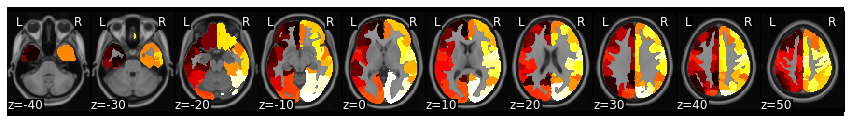

In [3]:
# Reading in cortical parcellations
mask = Brain_Data('/data/tools/schaefer_parcellations/MNI/Schaefer2018_100Parcels_Kong2022_17Networks_order_FSLMNI152_1mm.nii.gz')

# Splitting the one collection of parcellations into separate binary masks for each region
mask_x = expand_mask(mask)

# Viewing the mask
mask.plot()

In [4]:
# Defining a new function to get a participants's data from this specific ROI
def get_subject_roi(data, roi):
    
    # Creating an empty data dictionary
    sub_rois = {}
    
    # Iterating through each of the subjects
    for sub in data:
        
        # Copying the data within the index which corresponds with the specific ROI identified and saving it in the new dictionary
        sub_rois[sub] = data[sub].iloc[:, roi]
        
    # Returning a dataframe of that ROI's data for each participant
    return pd.DataFrame(sub_rois)

In [5]:
# Defining a new function to track progress in for loops
def tracker(iteration, 
            milestone = 5):
    
    # Check if this iteration hit a milestone
    if (iteration) % milestone == 0:
        
            # Printing progress
            print(f' {(iteration)} % Complete ! | {datetime.datetime.now()}')

In [6]:
# Creating a function to clean the data
def data_cleaner(filepath):
    
    # Calculating how many files each participant has in their raw directory
    if len(os.listdir(os.path.join('/data/Uncertainty/data/raw', sub, '3_task-1', 'DICOM'))) != 0:
        nFiles=len(os.listdir(os.path.join('/data/Uncertainty/data/raw', sub, '3_task-1', 'DICOM')))
    print

    # Reading in the data for this run
    data = pd.read_csv(filepath)

    # If this participant has 729 files
    if nFiles == 729:

        # Remove the first and last 30 observations (corresponding to the 60s buffer before and after)
        data = data.drop(data.index[range(30)])
        data = data.drop(data.tail(30).index)

    # If this participant has 759 files    
    if nFiles == 759:

        # Remove the first and last 30 observations (corresponding to the 90s buffer before and after)
        data = data.drop(data.index[range(45)])
        data = data.drop(data.tail(45).index)

    # If this participant doesn't jhave 729 or 759 files
    if nFiles != 729 and nFiles != 759:
        print(("Subject " + sub + " has " + str(nFiles) +" files in their raw directory, an abnormal quantity. Please check directory for errors."))

    # Reset the index 
    data = data.reset_index()
    data = data.drop(columns=['index'])

    # Adding participant data to the dictionary
    return data    

In [7]:
# Defining which subjects rated in the first half of the video
A_list = ['sub-0208', 'sub-2610', 'sub-2758', 'sub-3046', 'sub-3801',
            'sub-3951', 'sub-4407', 'sub-4590', 'sub-6021', 'sub-6269',
            'sub-6773', 'sub-6799', 'sub-7758', 'sub-8607', 'sub-8621',
            'sub-8746', 'sub-9436', 'sub-9827', 'sub-9907']

# Defining which subjects rated in the first half of the video
B_list = ['sub-0295', 'sub-0757', 'sub-2579', 'sub-3011', 'sub-3274',
            'sub-3952', 'sub-3981', 'sub-4781', 'sub-5006', 'sub-5849',
            'sub-6215', 'sub-6971', 'sub-6977', 'sub-7255', 'sub-7492', 
            'sub-8929']

n_bootstraps_isc = 10000
n_bootstraps_isc_group = 10000

# First Half Video Raters

In [8]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_A1 = {}

# Iterating through each of our subjects
for sub in A_list:

    # Cleaning the data
    sub_timeseries_A1[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                                       f'{sub}_run-1_nROI-100_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_A1, isc_p_A1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_A1, (roi)), 
                n_bootstraps= n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_A1[roi], isc_p_A1[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_A1.values()))
isc_padj_A1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_A1 = dict(zip(isc_p_A1.keys(), isc_padj_A1))
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_A1, isc_padj_brain_A1 = roi_to_brain(pd.Series(isc_r_A1), mask_x), roi_to_brain(pd.Series(isc_padj_A1), mask_x)
                          

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

 0 % Complete ! | 2024-05-16 16:01:47.250433
 5 % Complete ! | 2024-05-16 16:02:28.574341
 10 % Complete ! | 2024-05-16 16:03:13.953405
 15 % Complete ! | 2024-05-16 16:03:54.229417
 20 % Complete ! | 2024-05-16 16:04:36.936541
 25 % Complete ! | 2024-05-16 16:05:16.283435
 30 % Complete ! | 2024-05-16 16:05:51.370093
 35 % Complete ! | 2024-05-16 16:06:25.252141
 40 % Complete ! | 2024-05-16 16:07:06.759078
 45 % Complete ! | 2024-05-16 16:07:48.048268
 50 % Complete ! | 2024-05-16 16:08:32.624941
 55 % Complete ! | 2024-05-16 16:09:14.314308
 60 % Complete ! | 2024-05-16 16:09:56.663742
 65 % Complete ! | 2024-05-16 16:10:35.243792
 70 % Complete ! | 2024-05-16 16:11:18.039076
 75 % Complete ! | 2024-05-16 16:12:01.638289
 80 % Complete ! | 2024-05-16 16:12:41.295805
 85 % Complete ! | 2024-05-16 16:13:21.905582
 90 % Complete ! | 2024-05-16 16:14:04.388916
 95 % Complete ! | 2024-05-16 16:14:46.709861


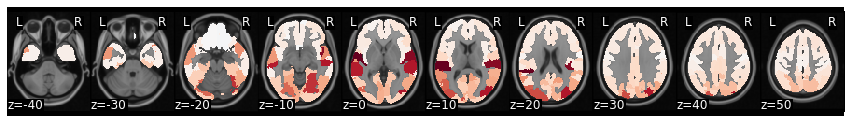

In [9]:
# Visualizing values with a slice plot
isc_r_brain_A1.plot(cmap='RdBu_r')

In [10]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_A1, isc_padj_brain_A1, thr=.01).to_nifti())

# First Half Video Non-Raters

In [11]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_B1 = {}

# Iterating through each of our subjects
for sub in B_list:

    # Cleaning the data
    sub_timeseries_B1[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-1_nROI-100_avgROI.csv'))  

# Creating dictionaries to house the statistic and significance
isc_r_B1, isc_p_B1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_B1, (roi)), 
                n_bootstraps= n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_B1[roi], isc_p_B1[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi) 

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_B1.values()))
isc_padj_B1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_B1 = dict(zip(isc_p_B1.keys(), isc_padj_B1))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_B1, isc_padj_brain_B1 = roi_to_brain(pd.Series(isc_r_B1), mask_x), roi_to_brain(pd.Series(isc_padj_B1), mask_x)
 

 0 % Complete ! | 2024-05-16 16:15:32.616650
 5 % Complete ! | 2024-05-16 16:16:16.229837
 10 % Complete ! | 2024-05-16 16:16:57.931379
 15 % Complete ! | 2024-05-16 16:17:39.358817
 20 % Complete ! | 2024-05-16 16:18:23.520414
 25 % Complete ! | 2024-05-16 16:19:04.575337
 30 % Complete ! | 2024-05-16 16:19:22.007549
 35 % Complete ! | 2024-05-16 16:19:49.574482
 40 % Complete ! | 2024-05-16 16:20:30.090748
 45 % Complete ! | 2024-05-16 16:21:13.467471
 50 % Complete ! | 2024-05-16 16:21:54.382845
 55 % Complete ! | 2024-05-16 16:22:37.021803
 60 % Complete ! | 2024-05-16 16:23:18.001248
 65 % Complete ! | 2024-05-16 16:23:57.598126
 70 % Complete ! | 2024-05-16 16:24:40.719514
 75 % Complete ! | 2024-05-16 16:25:20.886265
 80 % Complete ! | 2024-05-16 16:26:01.838122
 85 % Complete ! | 2024-05-16 16:26:43.753390
 90 % Complete ! | 2024-05-16 16:27:28.513044
 95 % Complete ! | 2024-05-16 16:28:09.838787


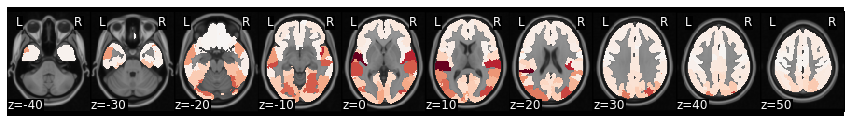

In [12]:
# Visualizing values with a slice plot
isc_r_brain_B1.plot(cmap='RdBu_r')

In [13]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_B1, isc_padj_brain_B1, thr=.01).to_nifti())

# First Half Rater v. Non-Rater Comparison

In [14]:
# Creating dictionaries to house the statistic and significance
isc_rdiff_R1, isc_p_R1 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    compare = isc_group(get_subject_roi(sub_timeseries_A1, (roi)),
                        get_subject_roi(sub_timeseries_B1, (roi)),
                        n_samples= n_bootstraps_isc_group, 
                        metric='median', 
                        method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_rdiff_R1[roi], isc_p_R1[roi] = compare['isc_group_difference'], compare['p']
    
    # Tracking Progress
    tracker(iteration = roi)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_R1.values()))
isc_padj_R1 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_R1 = dict(zip(isc_p_R1.keys(), isc_padj_R1))   
    
# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain_R1, isc_padj_brain_R1 = roi_to_brain(pd.Series(isc_rdiff_R1), mask_x), roi_to_brain(pd.Series(isc_padj_R1), mask_x)

 0 % Complete ! | 2024-05-16 16:29:03.722850
 5 % Complete ! | 2024-05-16 16:30:27.279783
 10 % Complete ! | 2024-05-16 16:31:52.666083
 15 % Complete ! | 2024-05-16 16:33:14.919556
 20 % Complete ! | 2024-05-16 16:34:37.036365
 25 % Complete ! | 2024-05-16 16:36:01.156529
 30 % Complete ! | 2024-05-16 16:37:23.180601
 35 % Complete ! | 2024-05-16 16:38:47.426365
 40 % Complete ! | 2024-05-16 16:40:13.277504
 45 % Complete ! | 2024-05-16 16:41:38.099341
 50 % Complete ! | 2024-05-16 16:42:59.682084
 55 % Complete ! | 2024-05-16 16:44:22.766171
 60 % Complete ! | 2024-05-16 16:45:47.944510
 65 % Complete ! | 2024-05-16 16:47:02.782988
 70 % Complete ! | 2024-05-16 16:48:20.370148
 75 % Complete ! | 2024-05-16 16:49:44.677525
 80 % Complete ! | 2024-05-16 16:51:09.489855
 85 % Complete ! | 2024-05-16 16:52:33.143339
 90 % Complete ! | 2024-05-16 16:53:55.505008
 95 % Complete ! | 2024-05-16 16:55:18.917979


In [15]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff_R1.values()), 
                   'P Value': list(isc_padj_R1.values())})

display(df[df['P Value'] < 0.01])

,R Difference,P Value
0,-0.008375,0.001428
3,-0.031351,0.001428
5,0.010072,0.001428
24,-0.036066,0.001428
37,0.013720,0.001428
41,-0.042657,0.001428
66,0.024884,0.001428


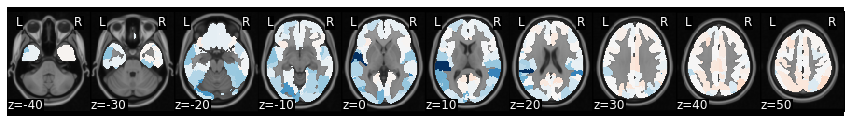

In [16]:
# Visualizing values with a slice plot
isc_rdiff_brain_R1.plot(cmap='RdBu_r')

In [17]:
# # 3D Image of the Brain Data
# index = [3,23,35,39,41,44,57,80,83,99]
# Rdiff = [-0.036,0.008, -0.137,-0.023,-0.044,-0.082,-0.050,-0.101,-0.019,-0.033]
# p=[0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001,0.001]

# # Create a DataFrame with 100 rows, initialized with zeros
# df = pd.DataFrame({'Rdiff': [0] * 100, 'p': [0] * 100})

# # Update the values based on the index array
# for i in range(len(index)):
#     df.loc[index[i], 'Rdiff'] = Rdiff[i]
#     df.loc[index[i], 'p'] = p[i]
        
# # Turning Rdiff back into an array
# isc_rdiff_R1 = df['Rdiff'].to_numpy()
# isc_padj_R1 = df['p'].to_numpy()

# # Projecting these values back to their corresponding mask regions 
# isc_rdiff_brain_R1, isc_padj_brain_R1 = roi_to_brain(pd.Series(isc_rdiff_R1), mask_x), roi_to_brain(pd.Series(isc_padj_R1), mask_x)

# view_img_on_surf(threshold(isc_rdiff_brain_R1, isc_padj_brain_R1, thr=.01).to_nifti(),cmap = "cold_white_hot", black_bg = True)

# Second Half Video Raters

In [18]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_B2 = {}

# Iterating through each of our subjects
for sub in B_list:

    # Cleaning the data
    sub_timeseries_B2[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-2_nROI-100_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_B2, isc_p_B2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_B2, (roi)), 
                n_bootstraps=n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_B2[roi], isc_p_B2[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi) 

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_B2.values()))
isc_padj_B2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_B2 = dict(zip(isc_p_B2.keys(), isc_padj_B2))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_B2, isc_padj_brain_B2 = roi_to_brain(pd.Series(isc_r_B2), mask_x), roi_to_brain(pd.Series(isc_padj_B2), mask_x)
                          

 0 % Complete ! | 2024-05-16 16:56:35.843528
 5 % Complete ! | 2024-05-16 16:57:16.971075
 10 % Complete ! | 2024-05-16 16:57:58.924833
 15 % Complete ! | 2024-05-16 16:58:40.834529
 20 % Complete ! | 2024-05-16 16:59:23.967972
 25 % Complete ! | 2024-05-16 17:00:04.101375
 30 % Complete ! | 2024-05-16 17:00:49.182757
 35 % Complete ! | 2024-05-16 17:01:31.859181
 40 % Complete ! | 2024-05-16 17:02:10.012605
 45 % Complete ! | 2024-05-16 17:02:50.938096
 50 % Complete ! | 2024-05-16 17:03:32.677947
 55 % Complete ! | 2024-05-16 17:04:17.426357
 60 % Complete ! | 2024-05-16 17:04:59.129949
 65 % Complete ! | 2024-05-16 17:05:38.852024
 70 % Complete ! | 2024-05-16 17:06:19.435525
 75 % Complete ! | 2024-05-16 17:07:01.461205
 80 % Complete ! | 2024-05-16 17:07:42.036707
 85 % Complete ! | 2024-05-16 17:08:23.008535
 90 % Complete ! | 2024-05-16 17:09:04.429362
 95 % Complete ! | 2024-05-16 17:09:45.677473


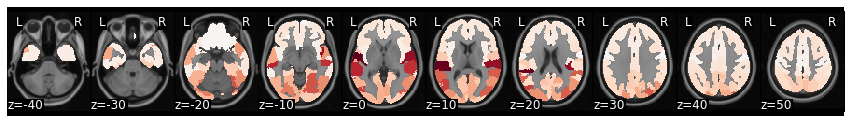

In [19]:
# Visualizing values with a slice plot
isc_r_brain_B2.plot(cmap='RdBu_r')

In [20]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_B2, isc_padj_brain_B2, thr=.01).to_nifti())

# Second Half Video Non-Raters

In [21]:
# NOTE: Participants saw a fixation and checkered pattern before and after each video. 
# Some were 60s and some were 90s (due to some early confusion). We want to remove that
# activation for everyone while paying special attention to which group they are in.

# Creating an empty dictionary to house subject data
sub_timeseries_A2 = {}

# Iterating through each of our subjects
for sub in A_list:

    # Cleaning the data
    sub_timeseries_A2[sub] = data_cleaner(os.path.join('/data/Uncertainty/scripts/3_Data/AvgROIs', 
                                          f'{sub}_run-2_nROI-100_avgROI.csv'))

# Creating dictionaries to house the statistic and significance
isc_r_A2, isc_p_A2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    stats = isc(get_subject_roi(sub_timeseries_A2, (roi)), 
                n_bootstraps=n_bootstraps_isc, 
                metric='median', 
                method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_r_A2[roi], isc_p_A2[roi] = stats['isc'], stats['p']
    
    # Tracking Progress
    tracker(iteration = roi)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_A2.values()))
isc_padj_A2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_A2 = dict(zip(isc_p_A2.keys(), isc_padj_A2))    
    
# Projecting these values back to their corresponding mask regions 
isc_r_brain_A2, isc_padj_brain_A2 = roi_to_brain(pd.Series(isc_r_A2), mask_x), roi_to_brain(pd.Series(isc_padj_A2), mask_x)
                  

 0 % Complete ! | 2024-05-16 17:10:34.003604
 5 % Complete ! | 2024-05-16 17:11:14.465334
 10 % Complete ! | 2024-05-16 17:11:59.566022
 15 % Complete ! | 2024-05-16 17:12:40.862843
 20 % Complete ! | 2024-05-16 17:13:22.618489
 25 % Complete ! | 2024-05-16 17:14:02.684861
 30 % Complete ! | 2024-05-16 17:14:45.067919
 35 % Complete ! | 2024-05-16 17:15:26.575638
 40 % Complete ! | 2024-05-16 17:16:08.450672
 45 % Complete ! | 2024-05-16 17:16:51.684299
 50 % Complete ! | 2024-05-16 17:17:31.547824
 55 % Complete ! | 2024-05-16 17:18:14.483696
 60 % Complete ! | 2024-05-16 17:18:59.851255
 65 % Complete ! | 2024-05-16 17:19:39.102649
 70 % Complete ! | 2024-05-16 17:20:21.014287
 75 % Complete ! | 2024-05-16 17:21:03.962397
 80 % Complete ! | 2024-05-16 17:21:47.041288
 85 % Complete ! | 2024-05-16 17:22:29.403094
 90 % Complete ! | 2024-05-16 17:23:11.969586
 95 % Complete ! | 2024-05-16 17:23:51.422542


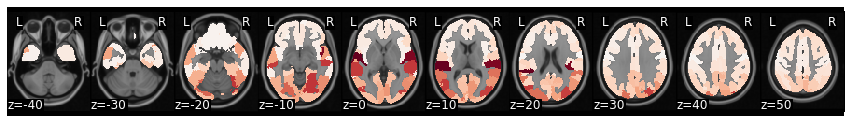

In [22]:
# Visualizing values with a slice plot
isc_r_brain_A2.plot(cmap='RdBu_r')

In [23]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_r_brain_A2, isc_padj_brain_A2, thr=.01).to_nifti())

# Second Half Rater v. Non-Rater Comparison

In [25]:
# Creating dictionaries to house the statistic and significance
isc_rdiff_R2, isc_p_R2 = {}, {}

# Iterating through all 100 ROIs
for roi in range(100):
    
    # Calculating the ISC for this region
    compare = isc_group(get_subject_roi(sub_timeseries_B2, (roi)),
                        get_subject_roi(sub_timeseries_A2, (roi)),
                        n_samples=n_bootstraps_isc_group, 
                        metric='median', 
                        method='bootstrap')
    
    # Saving the statistic and signficance to the dictionary
    isc_rdiff_R2[roi], isc_p_R2[roi] = compare['isc_group_difference'], compare['p']
    
    # Tracking Progress
    tracker(iteration = roi)

# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p_R2.values()))
isc_padj_R2 = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj_R2 = dict(zip(isc_p_R2.keys(), isc_padj_R2))    
            
# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain_R2, isc_padj_brain_R2 = roi_to_brain(pd.Series(isc_rdiff_R2), mask_x), roi_to_brain(pd.Series(isc_padj_R2), mask_x)

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)
/home/local/TU/tui81100/.local/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  

 0 % Complete ! | 2024-05-16 18:38:37.564554
 5 % Complete ! | 2024-05-16 18:40:02.363138
 10 % Complete ! | 2024-05-16 18:41:26.127690
 15 % Complete ! | 2024-05-16 18:42:51.200161
 20 % Complete ! | 2024-05-16 18:44:15.339428
 25 % Complete ! | 2024-05-16 18:45:40.608761
 30 % Complete ! | 2024-05-16 18:47:05.229638
 35 % Complete ! | 2024-05-16 18:48:28.592635
 40 % Complete ! | 2024-05-16 18:49:54.913865
 45 % Complete ! | 2024-05-16 18:51:20.449221
 50 % Complete ! | 2024-05-16 18:52:43.498869
 55 % Complete ! | 2024-05-16 18:54:12.585921
 60 % Complete ! | 2024-05-16 18:55:34.251417
 65 % Complete ! | 2024-05-16 18:56:56.047597
 70 % Complete ! | 2024-05-16 18:58:23.074449
 75 % Complete ! | 2024-05-16 18:59:45.895917
 80 % Complete ! | 2024-05-16 19:01:12.666969
 85 % Complete ! | 2024-05-16 19:02:36.624848
 90 % Complete ! | 2024-05-16 19:04:01.197304
 95 % Complete ! | 2024-05-16 19:05:23.887029


In [26]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff_R2.values()), 
                   'P Value': list(isc_padj_R2.values())})

display(df[df['P Value'] < 0.01])

,R Difference,P Value
5,0.018541,0.001667
21,0.006463,0.001667
22,0.010005,0.001667
41,0.024360,0.001667
50,-0.036312,0.001667
55,-0.033515,0.001667


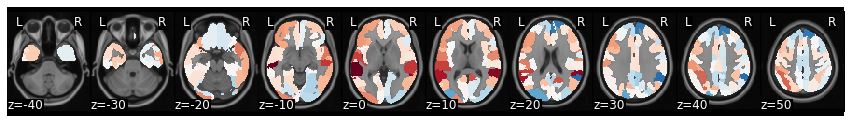

In [27]:
# Visualizing values with a slice plot
isc_rdiff_brain_R2.plot(cmap='RdBu_r')

In [28]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_rdiff_brain_R2, isc_padj_brain_R2, thr=.01).to_nifti())

# Combined Results

In [29]:
# Create a new dictionary to store the mean values
isc_rdiff = {}

# Iterate over the keys and calculate the mean for each key
for key in isc_rdiff_R2:
    isc_rdiff[key] = (isc_rdiff_R2[key] + isc_rdiff_R1[key]) / 2
    
# Create a new dictionary to store the combined p-values
isc_p = {}

# Iterate over the keys and apply Fisher's method
for key in isc_padj_R1:
    
    # Calculate the test statistic
    test_stat = -2 * (np.log(isc_p_R1[key]) + np.log(isc_p_R2[key]))
    
    # Calculate the combined p-value using the chi-square distribution
    combined_p = chi2.sf(test_stat, df=4)  # df = 2k, where k = 2 in this case
    
    # Store the combined p-value in the new dictionary
    isc_p[key] = combined_p
    
# Adjust p-values for multiple comparisons using the Benjamini-Hochberg procedure
p_values = np.array(list(isc_p.values()))
isc_padj = multipletests(p_values, alpha=0.01, method='fdr_bh')[1]
isc_padj = dict(zip(isc_p.keys(), isc_padj))    

# Projecting these values back to their corresponding mask regions 
isc_rdiff_brain, isc_padj_brain = roi_to_brain(pd.Series(isc_rdiff), mask_x), roi_to_brain(pd.Series(isc_padj), mask_x)

In [30]:
# Reporting regions showing significant differences
df = pd.DataFrame({'R Difference': list(isc_rdiff.values()), 
                   'P Value': list(isc_padj.values())})

display(df[df['P Value'] < 0.01])

,R Difference,P Value
0,-0.000213,0.009281
3,-0.006155,0.009258
5,0.014307,0.000010
21,-0.000691,0.009281
22,0.005017,0.009281
24,-0.016701,0.009281
37,0.009544,0.009258
41,-0.009149,0.000010
50,-0.016573,0.009258
55,-0.015798,0.009281


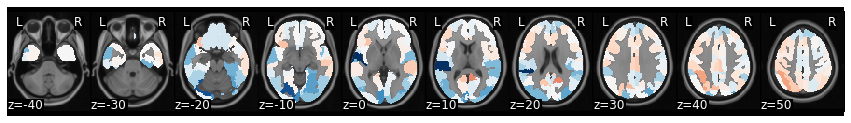

In [31]:
# Visualizing values with a slice plot
isc_rdiff_brain.plot(cmap='RdBu_r')

In [33]:
# 3D Image of the Brain Data
view_img_on_surf(threshold(isc_rdiff_brain, isc_padj_brain, thr=.001).to_nifti())